# Energy A.I. Hackathon 2025 Workflow - [Your Team Name]

Authors: Satvik Duddukuru (Departments of Computer Science and Mathematics, CNS), Joshua Yue (Departments of Computer Science and Mathematics, CNS), Parth Gupta (Department of Computer Science, CNS), Akshat Kumar (Department of Computer Science, CNS), Rashed Alsuhabi (Hildebrand Department of Petroleum and Geosystems, Cockrell School of Engineering)

The University of Texas at Austin, Austin, Texas, USA

### Executive Summary

1. Our goal: predict the energy required for hydraulic fracturing. 
2. What we did: cleaned data, implemented a categorical boost (CatBoost) algorithm, and developed an uncertainty model with data augmentation.
3. Learnings: building an effective workflow for categorical data sets, and understanding hydraulic fracturing problems. 
4. Recommendation: data thrives in numbers; more comprehensive data will benefit future endeavors. 


### Workflow Goal

The goal of this workflow is to gain a better understanding of the data available to us and use it to predict the target labels, namely energy consumption by type. 

### Workflow Steps

 - Data cleaning and imputation: dealing with missing values and combining targets
 - Feature selection: selecting the most important features
 - Model building: constructing the models to use for prediction
 - Uncertainty modeling: calculating realizations
 - Analysis: evaluating the results 

# Imports and style

In [1]:
import bisect
from catboost import CatBoostRegressor
# import ipywidgets as widgets
from IPython.display import display
from matplotlib import pyplot as plt
import numpy as np
import pandas as pd
from scipy.stats import norm
import seaborn as sns
from sklearn.base import clone
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error, mean_absolute_percentage_error
from sklearn.preprocessing import LabelEncoder
from sklearn.svm import SVR
from tqdm import tqdm

In [2]:
sns.set_theme()

# Data

Read the dataframe from "HackData2025.csv" and remove extraneous whitespace from columns

In [3]:
df = pd.read_csv("HackathonData2025.csv").sample(frac=1).reset_index(drop=True)
df.columns = [i.rstrip() for i in df.columns]
df

,Well Name,# Stages,# Clusters,Estimated Average Stage Time,Actual Average Stage Time,Frac Fleet,Fleet Type,Target Formation,Field Area,Ambient Temperature,Grid,Diesel,CNG,Fuel Type,Sand Provider
0,Wayne 2H,50,369,120.0,124.4,Fleet 12,Simul,Cowboy,CPE,NaN,0,99018,0,Diesel,SAND_C_A
1,Adams 3H,50,337,95.2,115.0,Fleet 15,Zipper,Cowboy,DKR,62.8,0,112668,0,Diesel,SAND_C_A
2,Clay 6H,50,348,NaN,128.0,Fleet 12,Simul,Cowboy,CPE,80.0,0,93639,0,Diesel,SAND_C_R
3,Cattaraugus 3H,64,398,95.2,118.0,Fleet 4,Zipper,Armadillo,Guadalupe,NaN,0,0,23434,Turbine,SAND_C_X
4,Taylor 5H,62,441,102.4,125.9,Fleet 1,Simul,Rodeo,Guadalupe,79.7,0,0,17832,Turbine,SAND_C_X
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1077,Big Stone 4H,64,420,120.0,130.6,Fleet 9,Simul,Lone Star,CPE,78.6,0,44843,12381,DGB,SAND_C_R
1078,Linn 1H,66,495,106.7,122.3,Fleet 1,Simul,Bluebonnet,Moody Center,84.2,0,0,19353,Turbine,SAND_C_X
1079,Lycoming 2H,51,406,NaN,108.1,Fleet 2,Simul,Magnolia,Guadalupe,NaN,0,0,9511,Turbine,SAND_C_A
1080,San Juan 2H,41,303,102.4,NaN,Fleet 2,Simul,Rodeo,DKR,64.4,0,0,9246,Turbine,SAND_C_X


Correlation heatmap to get an idea of how the features might be related

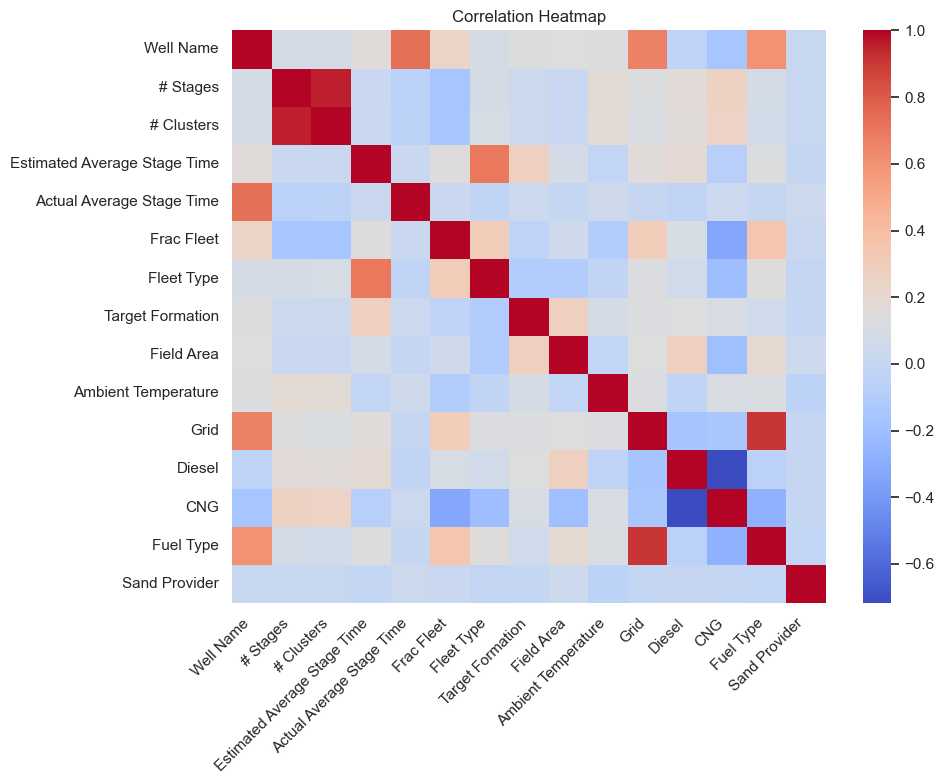

In [4]:
def compute_correlation(df):
    """
    Compute a correlation matrix for both numerical and categorical features using:
    - Pearson correlation for numerical features.
    - ANOVA to assign numerical values to categorical features, enabling Pearson correlation computation.
    """
    # Separate numerical and categorical columns
    numerical_cols = df.select_dtypes(include=[np.number]).columns
    categorical_cols = df.select_dtypes(exclude=[np.number]).columns

    # Convert categorical columns to numerical using ANOVA F-statistics
    cat_to_num = {}
    for cat_col in categorical_cols:
        unique_vals = df[cat_col].unique()
        groups = [df[df[cat_col] == val][numerical_cols].mean().values for val in unique_vals]
        group_means = {val: np.mean(group) for val, group in zip(unique_vals, groups)}
        cat_to_num[cat_col] = df[cat_col].map(group_means)

    # Replace categorical columns with their numerical representation
    for cat_col in cat_to_num:
        df[cat_col] = cat_to_num[cat_col]

    # Compute Pearson correlation for all columns
    corr_matrix = df.corr()

    return corr_matrix

def plot_correlation_heatmap(df):
    """
    Generate a heatmap of Pearson correlation for the dataframe after converting categorical columns.
    """
    # Create a copy of the dataframe to avoid modifying the original
    df_copy = df.copy()
    corr_matrix = compute_correlation(df_copy)

    plt.figure(figsize=(10, 8))
    sns.heatmap(corr_matrix, annot=False, fmt=".2f", cmap="coolwarm", cbar=True, 
                xticklabels=corr_matrix.columns, yticklabels=corr_matrix.index)
    plt.title("Correlation Heatmap")
    plt.xticks(rotation=45, ha='right')
    plt.tight_layout()
    plt.show()

plot_correlation_heatmap(df)

Some data is missing

In [5]:
df.isna().any()

Well Name                       False
# Stages                        False
# Clusters                      False
Estimated Average Stage Time     True
Actual Average Stage Time        True
Frac Fleet                      False
Fleet Type                       True
Target Formation                False
Field Area                      False
Ambient Temperature              True
Grid                            False
Diesel                          False
CNG                             False
Fuel Type                       False
Sand Provider                   False
dtype: bool

Clearly, time cannot be negative (in this context)

In [6]:
df[df["Actual Average Stage Time"] < 0] = np.NaN

Since each well name consists of a name and a letter-number combination, break these up into two features

In [7]:
df["Well Name 1"] = df["Well Name"].apply(lambda x: x.rsplit(" ", 1)[0] if type(x) is str else x)
df["Well Name 2"] = df["Well Name"].apply(lambda x: x.rsplit(" ", 1)[1] if type(x) is str else x)
df = df.drop("Well Name", axis=1)

Check if there is a linear correlation between estimated and actual stage time

In [8]:
times_no_nan = df.loc[:, ["Estimated Average Stage Time", "Actual Average Stage Time"]].dropna()

lr_model_time = LinearRegression()
lr_model_time.fit(
    times_no_nan[["Estimated Average Stage Time"]], 
    times_no_nan["Actual Average Stage Time"]
)
lr_model_time.score(
    times_no_nan[["Estimated Average Stage Time"]], 
    times_no_nan["Actual Average Stage Time"]
), lr_model_time.coef_[0], lr_model_time.intercept_

(0.6025454261037835, 0.7861168265995533, 32.571689226828425)

/Users/parthgupta/anaconda3/lib/python3.11/site-packages/sklearn/base.py:464: UserWarning: X does not have valid feature names, but LinearRegression was fitted with feature names
  warnings.warn(


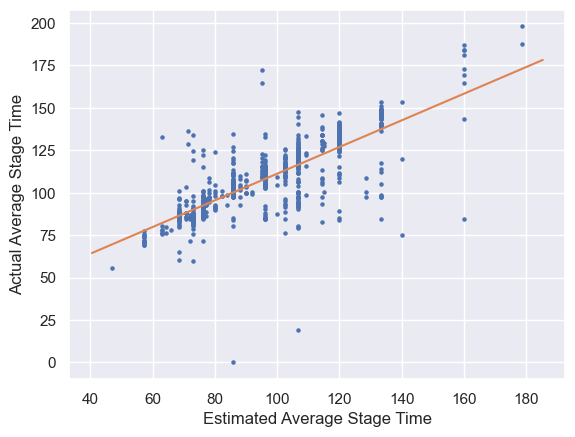

In [9]:
plt.scatter(
    df["Estimated Average Stage Time"],
    df["Actual Average Stage Time"],
    s=5
)
lr_x = np.array(plt.gca().get_xlim()).reshape(-1, 1)
lr_y = lr_model_time.predict(lr_x)
plt.plot(lr_x, lr_y, color="C1")
plt.xlabel("Estimated Average Stage Time")
plt.ylabel("Actual Average Stage Time")
plt.show()

Impute missing data for estimated and average stage time by using the linear model trained above

In [10]:
df = df.dropna(how="all", subset=["Estimated Average Stage Time", "Actual Average Stage Time"])
df = df.reset_index(drop=True)
est_time_missing = np.where(df.loc[:, "Estimated Average Stage Time"].isna())[0]
actual_time_missing = np.where(df.loc[:, "Actual Average Stage Time"].isna())[0]
df.loc[actual_time_missing, "Actual Average Stage Time"] = lr_model_time.predict(
    df.iloc[actual_time_missing][["Estimated Average Stage Time"]]
)
df.loc[est_time_missing, "Estimated Average Stage Time"] = (
    lr_model_time.coef_[0] * df.iloc[est_time_missing]["Actual Average Stage Time"]
) + lr_model_time.intercept_
df = df.drop("Actual Average Stage Time", axis=1)

Since a small number of samples have missing Fleet Type, it is safe to drop those samples

In [11]:
df = df.dropna(subset=["Fleet Type"])
df = df.reset_index(drop=True)

We don't necessarily care about time per stage and the number of stages independently; instead, calculate the total time

In [12]:
df["Total Estimated Stage Time"] = df["Estimated Average Stage Time"] * df["# Stages"]
estimated_average_stage_times = df["Estimated Average Stage Time"]
df = df.drop("Estimated Average Stage Time", axis=1)
df = df.drop("# Stages", axis=1)

For samples with missing ambient temperature, impute with a CatBoostRegressor

In [13]:
def make_categorical(full_df, col):
    full_df[col] = full_df[col].astype("category")
    return full_df

In [14]:
def get_categorical_columns(df):
    return list(df.select_dtypes(include="category").columns)

In [15]:
original_temp = df["Ambient Temperature"].copy()

X_at = df.loc[:, df.columns != "Ambient Temperature"]
X_at = df.loc[:, [i for i in X_at.columns if i not in ["CNG", "Diesel", "Grid", "Total Estimated Stage Time", "Total Energy Usage"]]]
for col in X_at.columns:
    if str(X_at[col].dtype) == "object":
        X_at = make_categorical(X_at, col)

y_at = df.loc[:, "Ambient Temperature"]
X_at_clean, y_at_clean = X_at[~y_at.isna()], y_at[~y_at.isna()]
at_model = CatBoostRegressor(one_hot_max_size=100, cat_features=get_categorical_columns(X_at))
grid = {
    "iterations": [500, 1000, 2000, 5000],
    "learning_rate": [0.005, 0.01, 0.05, 0.1],
    "depth": [2, 4, 6, 8, 10],
    "l2_leaf_reg": [1, 3, 5, 7, 10],
    "min_data_in_leaf": [1, 5, 10, 20, 50],
    "subsample": [0.7, 0.8, 0.9, 1.0],
    "bagging_temperature": [0.1, 0.25, 0.5, 1],
    "random_strength": [1, 3, 5],
    "grow_policy": ["SymmetricTree", "Depthwise", "Lossguide"]
}
at_model.randomized_search(grid, X_at_clean, y_at_clean)
pred_at = pd.Series(at_model.predict(X_at))
df["Ambient Temperature"] = df["Ambient Temperature"].fillna(pred_at)
df = df.drop("Field Area", axis=1)


0:	learn: 67.6879862	test: 66.6603467	best: 66.6603467 (0)	total: 59.2ms	remaining: 29.6s
1:	learn: 67.1135993	test: 66.0826888	best: 66.0826888 (1)	total: 65.2ms	remaining: 16.2s
2:	learn: 66.5494888	test: 65.5122095	best: 65.5122095 (2)	total: 69.9ms	remaining: 11.6s
3:	learn: 65.9581884	test: 64.9191514	best: 64.9191514 (3)	total: 74.3ms	remaining: 9.22s
4:	learn: 65.3840959	test: 64.3455156	best: 64.3455156 (4)	total: 78.1ms	remaining: 7.73s
5:	learn: 64.8404486	test: 63.8092970	best: 63.8092970 (5)	total: 83.6ms	remaining: 6.88s
6:	learn: 64.2765293	test: 63.2450894	best: 63.2450894 (6)	total: 88.7ms	remaining: 6.25s
7:	learn: 63.7277567	test: 62.6999366	best: 62.6999366 (7)	total: 92.5ms	remaining: 5.69s
8:	learn: 63.1952880	test: 62.1664327	best: 62.1664327 (8)	total: 97.5ms	remaining: 5.32s
9:	learn: 62.6784407	test: 61.6487344	best: 61.6487344 (9)	total: 103ms	remaining: 5.06s
10:	learn: 62.1558720	test: 61.1265077	best: 61.1265077 (10)	total: 109ms	remaining: 4.83s
11:	learn:

Since the distributions look similar, we don't have too much bias

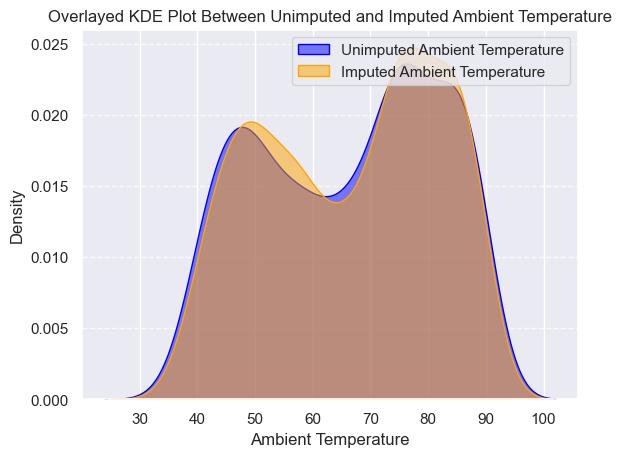

In [16]:
sns.kdeplot(original_temp, fill=True, alpha=0.5, color="blue", label="Unimputed Ambient Temperature")
sns.kdeplot(df["Ambient Temperature"].values, fill=True, alpha=0.5, color="orange", label="Imputed Ambient Temperature")
plt.title("Overlayed KDE Plot Between Unimputed and Imputed Ambient Temperature")
plt.xlabel("Ambient Temperature")
plt.ylabel("Density")
plt.legend()
plt.grid(axis="y", linestyle="--", alpha=0.8)
plt.show()

Combine the target labels so they are in the same units and sum the energy usage by field type

`diesel_scale` and `cng_scale` were determined by a combination of cursory searching and empirical evaluation

In [17]:
diesel_scale = 0.3 * 37.95
cng_scale = 0.3125 * 293.071
df["Total Energy Usage"] = df["Grid"] + df["Diesel"] * diesel_scale + df["CNG"] * cng_scale

In [18]:
diesel_values = df.loc[df["Fuel Type"] == "DGB"]["Diesel"] * diesel_scale
cng_values = df.loc[df["Fuel Type"] == "DGB"]["CNG"] * cng_scale

The Sand Provider does not seem to matter

In [19]:
df = df.drop("Sand Provider", axis=1)

Split the df by fuel type for convenient experimentation

In [20]:
fuel_types = df["Fuel Type"].unique()
split_dfs = {
    fuel_type: df[df["Fuel Type"] == fuel_type].drop("Fuel Type", axis=1).reset_index(drop=True)
    for fuel_type in fuel_types
}
fuel_types = np.append(fuel_types, "Full")
split_dfs["Full"] = df.drop("Fuel Type", axis=1).reset_index(drop=True)

In [21]:
targets = ["Grid", "Diesel", "CNG", "Total Energy Usage"]
feature_dfs = {
    fuel_type: split_dfs[fuel_type][[i for i in split_dfs[fuel_type].columns if i not in targets]]
    for fuel_type in fuel_types
}
target_dfs = {
    fuel_type: split_dfs[fuel_type][targets]
    for fuel_type in fuel_types
}

Mark categorical variables as categorical

In [22]:
for feature_df in feature_dfs.values():
    for col in feature_df.columns:
        if str(feature_df[col].dtype) == "object":
            feature_df = make_categorical(feature_df, col)

/var/folders/ny/w1jqd5s96jjfbn0mgn5xyc3c0000gn/T/ipykernel_42407/1937108308.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  full_df[col] = full_df[col].astype("category")
/var/folders/ny/w1jqd5s96jjfbn0mgn5xyc3c0000gn/T/ipykernel_42407/1937108308.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  full_df[col] = full_df[col].astype("category")
/var/folders/ny/w1jqd5s96jjfbn0mgn5xyc3c0000gn/T/ipykernel_42407/1937108308.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a

Drop samples with values more than 2 standard deviations from the center if `want_to_drop_outliers` is set to `True`

In [23]:
def drop_outliers(feature_df, target_df):
    feature_df = feature_df[feature_df.apply(lambda x : (x-x.mean()).abs()<(2*x.std()) if not pd.api.types.is_categorical_dtype(x) else x).all(1)]
    return feature_df.reset_index(drop=True), target_df.iloc[feature_df.index].reset_index(drop=True)

In [24]:
want_to_drop_outliers = False

In [25]:
if want_to_drop_outliers:
    for fuel_type in fuel_types:
        feature_dfs[fuel_type], target_dfs[fuel_type] = drop_outliers(feature_dfs[fuel_type], target_dfs[fuel_type])

Utility function to get target dataframe for the desired fuel_type

In [26]:
def get_target_df(fuel_type):
    if fuel_type == "Turbine":
        return target_dfs[fuel_type]["CNG"]
    elif fuel_type == "Grid":
        return target_dfs[fuel_type]["Grid"]
    elif fuel_type == "Diesel":
        return target_dfs[fuel_type]["Diesel"]
    elif fuel_type == "DGB":
        return target_dfs[fuel_type][["Diesel", "CNG"]]
    elif fuel_type == "Full":
        return target_dfs[fuel_type]["Total Energy Usage"]

# Modelling

Function to train CatBoostRegressors with K-fold cross-validation and return model performance and the models themselves

In [27]:
def score_model_cat(model, feature_df, target_df, num_folds=5, use_grid=False):
    scores = []
    models = []
    y_pred = []
    y_true = []
    for i in tqdm(range(num_folds)):
        start = len(feature_df) * i // num_folds
        end = len(feature_df) * (i+1) // num_folds
        fold = feature_df.index.isin(range(start, end))
        m = clone(model)
        m.set_params(eval_metric="RMSE")
        grid = {
            "iterations": [500, 1000, 2000, 5000],
            "learning_rate": [0.005, 0.01, 0.05, 0.1],
            "depth": [2, 4, 6, 8, 10],
            "l2_leaf_reg": [1, 3, 5, 7, 10],
            "min_data_in_leaf": [1, 5, 10, 20, 50],
            "subsample": [0.7, 0.8, 0.9, 1.0],
            "bagging_temperature": [0.1, 0.25, 0.5, 1],
            "random_strength": [1, 3, 5],
            "grow_policy": ["SymmetricTree", "Depthwise", "Lossguide"]
        }
        if use_grid:
            m.randomized_search(grid, feature_df[~fold], target_df[~fold])
        else:
            m.fit(feature_df[~fold], target_df[~fold])
        predictions = m.predict(feature_df[fold])
        scores.append(mean_absolute_percentage_error(target_df[fold], predictions))
        models.append(m)
        y_pred += list(predictions)
        y_true += list(target_df[fold])
    return scores, models, y_true, y_pred

## Feature selection

Fit a CatBoostRegressor to the entire dataset to get feature importances

In [28]:
X, y = feature_dfs["Full"], get_target_df("Full")

In [29]:
model = CatBoostRegressor(one_hot_max_size=100, cat_features=list(X.select_dtypes(include="category").columns))
scores, models, y_true, y_pred = score_model_cat(model, X, y, use_grid=False)

  0%|          | 0/5 [00:00<?, ?it/s]

Learning rate set to 0.0398
0:	learn: 432977.0436597	total: 1.28ms	remaining: 1.28s
1:	learn: 423701.0170301	total: 3.17ms	remaining: 1.58s
2:	learn: 416725.8717337	total: 3.88ms	remaining: 1.29s
3:	learn: 408376.7934445	total: 4.68ms	remaining: 1.17s
4:	learn: 400163.7868159	total: 5.65ms	remaining: 1.13s
5:	learn: 392411.7935835	total: 6.67ms	remaining: 1.1s
6:	learn: 385775.9966286	total: 7.6ms	remaining: 1.08s
7:	learn: 377600.5462147	total: 8.59ms	remaining: 1.06s
8:	learn: 370360.7435683	total: 9.52ms	remaining: 1.05s
9:	learn: 363128.2409956	total: 10.5ms	remaining: 1.04s
10:	learn: 356339.6884813	total: 11.4ms	remaining: 1.02s
11:	learn: 349625.2445930	total: 12.2ms	remaining: 1.01s
12:	learn: 343323.4819407	total: 13.2ms	remaining: 1s
13:	learn: 337977.9643699	total: 14.2ms	remaining: 998ms
14:	learn: 333492.4349631	total: 14.9ms	remaining: 977ms
15:	learn: 327847.4905534	total: 15.6ms	remaining: 959ms
16:	learn: 322656.1313265	total: 16.4ms	remaining: 951ms
17:	learn: 318291.

 20%|██        | 1/5 [00:01<00:04,  1.01s/it]

798:	learn: 74679.7685721	total: 762ms	remaining: 192ms
799:	learn: 74620.7532876	total: 763ms	remaining: 191ms
800:	learn: 74521.3210632	total: 764ms	remaining: 190ms
801:	learn: 74454.3569260	total: 765ms	remaining: 189ms
802:	learn: 74423.5913334	total: 765ms	remaining: 188ms
803:	learn: 74347.0009933	total: 766ms	remaining: 187ms
804:	learn: 74303.4520372	total: 767ms	remaining: 186ms
805:	learn: 74202.3197833	total: 768ms	remaining: 185ms
806:	learn: 74161.4429023	total: 769ms	remaining: 184ms
807:	learn: 74112.0521256	total: 769ms	remaining: 183ms
808:	learn: 74024.9229289	total: 770ms	remaining: 182ms
809:	learn: 73982.2880751	total: 771ms	remaining: 181ms
810:	learn: 73919.0923599	total: 772ms	remaining: 180ms
811:	learn: 73875.8085983	total: 773ms	remaining: 179ms
812:	learn: 73869.0183878	total: 773ms	remaining: 178ms
813:	learn: 73794.4578318	total: 774ms	remaining: 177ms
814:	learn: 73735.0102741	total: 775ms	remaining: 176ms
815:	learn: 73693.4143129	total: 776ms	remaining

 40%|████      | 2/5 [00:01<00:02,  1.07it/s]

932:	learn: 70685.3410438	total: 775ms	remaining: 55.7ms
933:	learn: 70627.9533947	total: 776ms	remaining: 54.8ms
934:	learn: 70585.7202747	total: 777ms	remaining: 54ms
935:	learn: 70521.9903660	total: 778ms	remaining: 53.2ms
936:	learn: 70467.6419222	total: 779ms	remaining: 52.4ms
937:	learn: 70432.1683406	total: 780ms	remaining: 51.5ms
938:	learn: 70383.1098667	total: 781ms	remaining: 50.7ms
939:	learn: 70322.3230391	total: 782ms	remaining: 49.9ms
940:	learn: 70267.8487141	total: 783ms	remaining: 49.1ms
941:	learn: 70215.6626165	total: 783ms	remaining: 48.2ms
942:	learn: 70214.4248430	total: 785ms	remaining: 47.5ms
943:	learn: 70160.1148025	total: 786ms	remaining: 46.6ms
944:	learn: 70059.5019033	total: 787ms	remaining: 45.8ms
945:	learn: 70011.5844969	total: 788ms	remaining: 45ms
946:	learn: 69955.7169044	total: 789ms	remaining: 44.1ms
947:	learn: 69914.5143159	total: 789ms	remaining: 43.3ms
948:	learn: 69912.9361183	total: 790ms	remaining: 42.5ms
949:	learn: 69875.1409430	total: 79

 60%|██████    | 3/5 [00:02<00:01,  1.07it/s]

Learning rate set to 0.039793
0:	learn: 434504.1751463	total: 1.05ms	remaining: 1.05s
1:	learn: 424375.0892978	total: 1.96ms	remaining: 979ms
2:	learn: 417869.4115897	total: 2.56ms	remaining: 852ms
3:	learn: 409658.7584315	total: 3.33ms	remaining: 828ms
4:	learn: 401170.6333192	total: 4.21ms	remaining: 838ms
5:	learn: 394066.1141832	total: 5.11ms	remaining: 847ms
6:	learn: 387497.4359327	total: 5.97ms	remaining: 847ms
7:	learn: 379732.8921288	total: 7.02ms	remaining: 871ms
8:	learn: 373046.5782988	total: 7.9ms	remaining: 870ms
9:	learn: 366478.9820055	total: 8.74ms	remaining: 865ms
10:	learn: 359954.7537822	total: 9.63ms	remaining: 866ms
11:	learn: 353712.4005336	total: 10.5ms	remaining: 866ms
12:	learn: 347165.1353060	total: 11.4ms	remaining: 869ms
13:	learn: 341316.0837771	total: 12.6ms	remaining: 887ms
14:	learn: 335709.1438073	total: 13.5ms	remaining: 886ms
15:	learn: 328954.7685199	total: 14.4ms	remaining: 883ms
16:	learn: 323443.9487117	total: 15.1ms	remaining: 876ms
17:	learn: 3

 80%|████████  | 4/5 [00:03<00:00,  1.06it/s]

870:	learn: 72673.9175092	total: 765ms	remaining: 113ms
871:	learn: 72574.4583736	total: 767ms	remaining: 113ms
872:	learn: 72521.4108877	total: 768ms	remaining: 112ms
873:	learn: 72486.1482464	total: 769ms	remaining: 111ms
874:	learn: 72482.2125663	total: 770ms	remaining: 110ms
875:	learn: 72429.4484794	total: 770ms	remaining: 109ms
876:	learn: 72313.6332527	total: 771ms	remaining: 108ms
877:	learn: 72216.9781153	total: 772ms	remaining: 107ms
878:	learn: 72196.8652528	total: 773ms	remaining: 106ms
879:	learn: 72149.6450525	total: 774ms	remaining: 106ms
880:	learn: 72106.4974058	total: 776ms	remaining: 105ms
881:	learn: 71971.1950063	total: 777ms	remaining: 104ms
882:	learn: 71911.2008485	total: 778ms	remaining: 103ms
883:	learn: 71869.5468654	total: 779ms	remaining: 102ms
884:	learn: 71797.1521680	total: 780ms	remaining: 101ms
885:	learn: 71751.3252964	total: 781ms	remaining: 100ms
886:	learn: 71722.0582797	total: 782ms	remaining: 99.6ms
887:	learn: 71648.2297584	total: 783ms	remainin

100%|██████████| 5/5 [00:04<00:00,  1.06it/s]

959:	learn: 61902.4663922	total: 831ms	remaining: 34.6ms
960:	learn: 61851.8044297	total: 832ms	remaining: 33.8ms
961:	learn: 61774.2317109	total: 833ms	remaining: 32.9ms
962:	learn: 61741.1784279	total: 835ms	remaining: 32.1ms
963:	learn: 61692.4932252	total: 835ms	remaining: 31.2ms
964:	learn: 61686.9966105	total: 836ms	remaining: 30.3ms
965:	learn: 61650.7560043	total: 837ms	remaining: 29.5ms
966:	learn: 61574.9030967	total: 838ms	remaining: 28.6ms
967:	learn: 61521.0208063	total: 838ms	remaining: 27.7ms
968:	learn: 61464.6007173	total: 839ms	remaining: 26.9ms
969:	learn: 61462.9536203	total: 840ms	remaining: 26ms
970:	learn: 61393.8789734	total: 841ms	remaining: 25.1ms
971:	learn: 61345.9765949	total: 842ms	remaining: 24.2ms
972:	learn: 61285.1292836	total: 842ms	remaining: 23.4ms
973:	learn: 61207.0469987	total: 843ms	remaining: 22.5ms
974:	learn: 61199.8784677	total: 844ms	remaining: 21.6ms
975:	learn: 61125.9092712	total: 845ms	remaining: 20.8ms
976:	learn: 61088.9781870	total: 

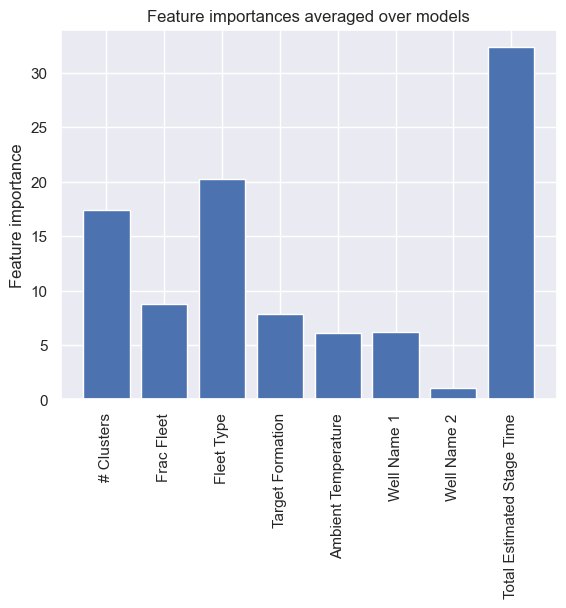

In [30]:
plt.bar(models[0].feature_names_, np.mean([i.feature_importances_ for i in models], axis=0))
plt.ylabel("Feature importance")
plt.title("Feature importances averaged over models")
plt.xticks(rotation=90)
plt.show()

In [31]:
num_features_to_include = 7 # chosen by inspection of the bar graph
important_features = [np.asarray(m.feature_names_)[np.argwhere(m.feature_importances_ >= np.partition(m.feature_importances_, -num_features_to_include)[-num_features_to_include])].reshape(1, -1).tolist()[0] for m in models][0]

## Training

Fit a CatBoostRegressor on the important features with cross-validation

In [32]:
model2 = CatBoostRegressor(one_hot_max_size=100, cat_features=get_categorical_columns(X[important_features]))
scores, models, y_true, y_pred = score_model_cat(model2, X[important_features], y, use_grid=True)

  0%|          | 0/5 [00:00<?, ?it/s]

0:	learn: 1399360.6679371	test: 1400045.2040769	best: 1400045.2040769 (0)	total: 11.2ms	remaining: 5.59s
1:	learn: 1387668.4881609	test: 1388446.7732364	best: 1388446.7732364 (1)	total: 20.6ms	remaining: 5.14s
2:	learn: 1376575.8540584	test: 1377539.1540986	best: 1377539.1540986 (2)	total: 21.4ms	remaining: 3.55s
3:	learn: 1364478.7687550	test: 1365582.6585193	best: 1365582.6585193 (3)	total: 22ms	remaining: 2.73s
4:	learn: 1353267.6262481	test: 1354144.4338096	best: 1354144.4338096 (4)	total: 27.8ms	remaining: 2.76s
5:	learn: 1341874.9888470	test: 1342541.2990293	best: 1342541.2990293 (5)	total: 33.7ms	remaining: 2.77s
6:	learn: 1330831.5051713	test: 1331362.6468101	best: 1331362.6468101 (6)	total: 42.2ms	remaining: 2.97s
7:	learn: 1319664.9654338	test: 1320176.9566828	best: 1320176.9566828 (7)	total: 58.4ms	remaining: 3.59s
8:	learn: 1308645.3001742	test: 1309116.1636345	best: 1309116.1636345 (8)	total: 74.5ms	remaining: 4.06s
9:	learn: 1297679.7052714	test: 1298192.9800716	best: 129

 20%|██        | 1/5 [01:08<04:34, 68.73s/it]

0:	learn: 1429669.9940809	test: 1329222.7550767	best: 1329222.7550767 (0)	total: 1.06ms	remaining: 531ms
1:	learn: 1417714.3005431	test: 1317375.9653133	best: 1317375.9653133 (1)	total: 2.17ms	remaining: 539ms
2:	learn: 1405703.1624661	test: 1305873.9299699	best: 1305873.9299699 (2)	total: 2.87ms	remaining: 475ms
3:	learn: 1394175.4795697	test: 1294452.4992437	best: 1294452.4992437 (3)	total: 3.65ms	remaining: 452ms
4:	learn: 1382232.7044510	test: 1282630.8550369	best: 1282630.8550369 (4)	total: 4.29ms	remaining: 425ms
5:	learn: 1371030.4820147	test: 1271417.1755405	best: 1271417.1755405 (5)	total: 5ms	remaining: 412ms
6:	learn: 1360013.9761146	test: 1260631.5743694	best: 1260631.5743694 (6)	total: 5.96ms	remaining: 420ms
7:	learn: 1349022.5692877	test: 1249845.1996196	best: 1249845.1996196 (7)	total: 7.32ms	remaining: 450ms
8:	learn: 1338015.3449183	test: 1239034.8869038	best: 1239034.8869038 (8)	total: 8.88ms	remaining: 485ms
9:	learn: 1326758.1309459	test: 1228036.5196804	best: 1228

 40%|████      | 2/5 [02:24<03:38, 72.67s/it]

0:	learn: 1446666.2159266	test: 1311874.3009848	best: 1311874.3009848 (0)	total: 873us	remaining: 436ms
1:	learn: 1434866.6697993	test: 1300063.0982309	best: 1300063.0982309 (1)	total: 2.35ms	remaining: 587ms
2:	learn: 1422630.7584164	test: 1287736.3922562	best: 1287736.3922562 (2)	total: 3.03ms	remaining: 502ms
3:	learn: 1410674.8423108	test: 1275998.4015271	best: 1275998.4015271 (3)	total: 4.25ms	remaining: 528ms
4:	learn: 1398682.1428826	test: 1264016.1683952	best: 1264016.1683952 (4)	total: 5.48ms	remaining: 543ms
5:	learn: 1387228.1590828	test: 1252947.8731109	best: 1252947.8731109 (5)	total: 6.54ms	remaining: 539ms
6:	learn: 1375691.5713254	test: 1241403.5420935	best: 1241403.5420935 (6)	total: 7.22ms	remaining: 509ms
7:	learn: 1364164.3619075	test: 1230195.2837559	best: 1230195.2837559 (7)	total: 8.55ms	remaining: 526ms
8:	learn: 1353383.7419197	test: 1219310.1956634	best: 1219310.1956634 (8)	total: 10.2ms	remaining: 556ms
9:	learn: 1342106.2280749	test: 1208182.1092241	best: 12

 60%|██████    | 3/5 [03:39<02:28, 74.03s/it]

0:	learn: 1436506.9981966	test: 1292846.1260370	best: 1292846.1260370 (0)	total: 1.17ms	remaining: 585ms
1:	learn: 1424264.4762701	test: 1280730.3624495	best: 1280730.3624495 (1)	total: 2.36ms	remaining: 589ms
2:	learn: 1412307.0346620	test: 1268977.9551750	best: 1268977.9551750 (2)	total: 3ms	remaining: 496ms
3:	learn: 1400445.7292267	test: 1257454.9636036	best: 1257454.9636036 (3)	total: 3.89ms	remaining: 483ms
4:	learn: 1388868.5281041	test: 1246172.2992984	best: 1246172.2992984 (4)	total: 4.66ms	remaining: 461ms
5:	learn: 1377178.3638888	test: 1234541.7844475	best: 1234541.7844475 (5)	total: 6.67ms	remaining: 549ms
6:	learn: 1365955.8776966	test: 1223290.0867788	best: 1223290.0867788 (6)	total: 7.79ms	remaining: 548ms
7:	learn: 1354884.6016961	test: 1212462.9519682	best: 1212462.9519682 (7)	total: 8.5ms	remaining: 523ms
8:	learn: 1343751.2276968	test: 1201717.0358044	best: 1201717.0358044 (8)	total: 9.56ms	remaining: 522ms
9:	learn: 1332799.4291658	test: 1190913.9552535	best: 11909

 80%|████████  | 4/5 [04:52<01:13, 73.44s/it]

0:	learn: 1442888.4088096	test: 1337743.4658407	best: 1337743.4658407 (0)	total: 860us	remaining: 429ms
1:	learn: 1431073.6915515	test: 1326125.0617422	best: 1326125.0617422 (1)	total: 2.97ms	remaining: 741ms
2:	learn: 1418710.4765223	test: 1313945.0635044	best: 1313945.0635044 (2)	total: 3.78ms	remaining: 626ms
3:	learn: 1406809.2416226	test: 1302294.0875476	best: 1302294.0875476 (3)	total: 4.96ms	remaining: 615ms
4:	learn: 1394676.4787916	test: 1290853.1083793	best: 1290853.1083793 (4)	total: 7.23ms	remaining: 716ms
5:	learn: 1382611.4006870	test: 1279099.2266100	best: 1279099.2266100 (5)	total: 8.06ms	remaining: 664ms
6:	learn: 1371159.1727393	test: 1267988.3381601	best: 1267988.3381601 (6)	total: 9.03ms	remaining: 636ms
7:	learn: 1359360.9253834	test: 1256525.4467579	best: 1256525.4467579 (7)	total: 9.72ms	remaining: 598ms
8:	learn: 1348261.8633745	test: 1245756.7915044	best: 1245756.7915044 (8)	total: 14.6ms	remaining: 798ms
9:	learn: 1336998.4352790	test: 1235301.5811972	best: 12

100%|██████████| 5/5 [06:09<00:00, 73.94s/it]


Function to get the coefficient of determination between two arrays (that are expected to be linearly correlated)

In [33]:
def get_r2(a, b):
    a = a.reshape(-1, 1)
    model = LinearRegression()
    model.fit(a, b)
    return model.score(a, b)

In [34]:
get_r2(np.asarray(y_true), y_pred) # pretty good

0.8772250515620176

Visualize predictions vs true energy usage

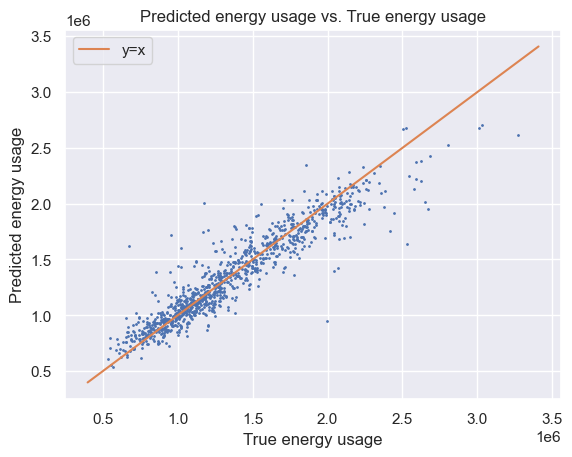

In [35]:
plt.scatter(y_true, y_pred, s=1)
plt.plot(plt.gca().get_xlim(), plt.gca().get_xlim(), color="C1", label="y=x")
plt.xlabel("True energy usage")
plt.ylabel("Predicted energy usage")
plt.title("Predicted energy usage vs. True energy usage")
plt.legend()
plt.show()

In [36]:
def get_stats(models, feature_df, target_df, feature_index=5):
    for model in models[:1]:
        res = model.calc_feature_statistics(feature_df, target_df, plot=True, feature=feature_index)
        plt.show()

In [37]:
# feature_statistics_slider = widgets.IntSlider(value=0, min=0, max=len(X[important_features].columns)-1, step=1, description='Index:')
# widgets.interactive(lambda row_number: get_stats(models, X[important_features], y, row_number), row_number=feature_statistics_slider)

In [38]:
y_pred_arr, y_true_arr = np.asarray(y_pred), np.asarray(y_true)

Visualize residuals

In [39]:
residuals = y_true_arr - y_pred_arr
mu, std = norm.fit(residuals)
residual_variance = std ** 2
uncertainty = residual_variance ** 0.5

In [40]:
def get_corr(alpha=0.5):
    z_scores = np.geomspace(0.01, 2.5)
    includeds = []
    for z_score in z_scores:
        lower_bound = y_pred_arr - z_score * uncertainty * alpha
        upper_bound = y_pred_arr + z_score * uncertainty * alpha
        includeds.append(((lower_bound < y_true_arr) & (y_true_arr < upper_bound)).mean())
    includeds = np.asarray(includeds)
    return np.abs(includeds - (1 - norm(0, 1).cdf(-np.absolute(z_scores)) * 2)).mean()

Text(0.5, 1.0, 'Error in residual distribution by scaling (alpha)')

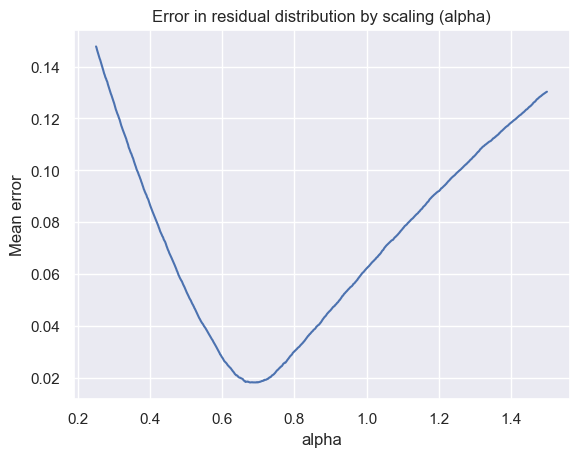

In [41]:
alpha_vals = np.linspace(0.25, 1.5, 1000)
errors_per_alpha = [get_corr(i) for i in alpha_vals]
plt.plot(alpha_vals, errors_per_alpha)
plt.ylabel("Mean error")
plt.xlabel("alpha")
plt.title("Error in residual distribution by scaling (alpha)")

Text(0.5, 0, 'actual inclusion')

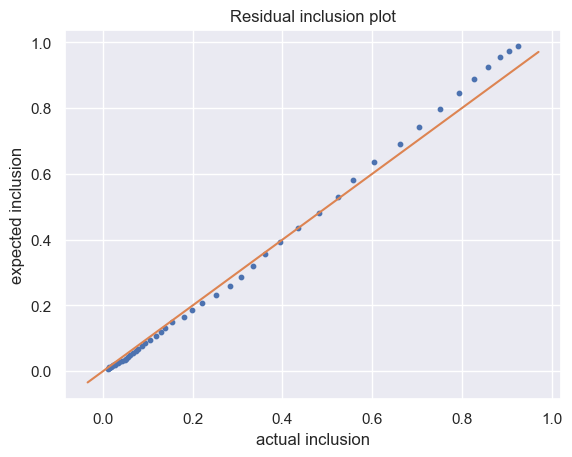

In [42]:
alpha = alpha_vals[np.argmin(errors_per_alpha)]
z_scores = np.geomspace(0.01, 2.5)
includeds = []
for z_score in z_scores:
    lower_bound = y_pred_arr - z_score * uncertainty * alpha
    upper_bound = y_pred_arr + z_score * uncertainty * alpha
    includeds.append(((lower_bound < y_true_arr) & (y_true_arr < upper_bound)).mean())
includeds = np.asarray(includeds)
plt.scatter(includeds, 1 - norm(0, 1).cdf(-np.absolute(z_scores)) * 2, s=10)
plt.plot(plt.gca().get_xlim(), plt.gca().get_xlim(), color="C1")
plt.title("Residual inclusion plot")
plt.ylabel("expected inclusion")
plt.xlabel("actual inclusion")

In [43]:
get_r2(includeds, 1 - norm(0, 1).cdf(-np.absolute(z_scores)) * 2)

0.9985799335721918

Make model on full training set

In [44]:
def get_full_model(model, feature_df, target_df):
    m = clone(model)
    m.set_params(eval_metric="RMSE")
    grid = {
        "iterations": [500, 1000, 2000, 5000],
        "learning_rate": [0.005, 0.01, 0.05, 0.1],
        "depth": [2, 4, 6, 8, 10],
        "l2_leaf_reg": [1, 3, 5, 7, 10],
        "min_data_in_leaf": [1, 5, 10, 20, 50],
        "subsample": [0.7, 0.8, 0.9, 1.0],
        "bagging_temperature": [0.1, 0.25, 0.5, 1],
        "random_strength": [1, 3, 5],
        "grow_policy": ["SymmetricTree", "Depthwise", "Lossguide"]
    }
    m.randomized_search(grid, feature_df, target_df)
    return m

In [45]:
full_model = CatBoostRegressor(one_hot_max_size=100, cat_features=get_categorical_columns(X[important_features]))
full_model = get_full_model(full_model, X[important_features], y)

0:	learn: 1419617.2803050	test: 1379999.2824808	best: 1379999.2824808 (0)	total: 4.06ms	remaining: 2.03s
1:	learn: 1406978.8359035	test: 1367412.7334839	best: 1367412.7334839 (1)	total: 5.67ms	remaining: 1.41s
2:	learn: 1394634.1693771	test: 1355053.5543982	best: 1355053.5543982 (2)	total: 8.8ms	remaining: 1.46s
3:	learn: 1382723.4643123	test: 1343156.7347383	best: 1343156.7347383 (3)	total: 12.6ms	remaining: 1.56s
4:	learn: 1370955.5015191	test: 1331480.2638745	best: 1331480.2638745 (4)	total: 17.3ms	remaining: 1.72s
5:	learn: 1359384.3436894	test: 1320047.8904405	best: 1320047.8904405 (5)	total: 21.6ms	remaining: 1.77s
6:	learn: 1348276.0254512	test: 1308855.4101230	best: 1308855.4101230 (6)	total: 26ms	remaining: 1.83s
7:	learn: 1336740.1736548	test: 1297491.2353901	best: 1297491.2353901 (7)	total: 30ms	remaining: 1.85s
8:	learn: 1325576.6347817	test: 1286486.9784460	best: 1286486.9784460 (8)	total: 35ms	remaining: 1.91s
9:	learn: 1314346.0568983	test: 1275332.4949952	best: 1275332.

Make model to impute missing Estimated Average Stage Time in the test data

In [46]:
east_model = CatBoostRegressor(one_hot_max_size=100, cat_features=get_categorical_columns(feature_dfs["Full"]))
east_model.fit(feature_dfs["Full"].loc[:, feature_dfs["Full"].columns != "Total Estimated Stage Time"], estimated_average_stage_times)

Learning rate set to 0.041222
0:	learn: 22.1742618	total: 1.75ms	remaining: 1.75s
1:	learn: 21.8026892	total: 2.35ms	remaining: 1.17s
2:	learn: 21.3500189	total: 4.17ms	remaining: 1.39s
3:	learn: 21.0209536	total: 4.46ms	remaining: 1.11s
4:	learn: 20.6096054	total: 5.46ms	remaining: 1.08s
5:	learn: 20.2491184	total: 6.14ms	remaining: 1.02s
6:	learn: 19.8971362	total: 7.64ms	remaining: 1.08s
7:	learn: 19.6432582	total: 7.92ms	remaining: 982ms
8:	learn: 19.3465315	total: 9.08ms	remaining: 1s
9:	learn: 19.0799741	total: 10.3ms	remaining: 1.02s
10:	learn: 18.7905852	total: 11.3ms	remaining: 1.02s
11:	learn: 18.5414491	total: 12.3ms	remaining: 1.01s
12:	learn: 18.3597760	total: 12.5ms	remaining: 952ms
13:	learn: 18.0873144	total: 13.3ms	remaining: 937ms
14:	learn: 17.8862648	total: 14.2ms	remaining: 934ms
15:	learn: 17.6387447	total: 15.1ms	remaining: 927ms
16:	learn: 17.4014978	total: 16.1ms	remaining: 929ms
17:	learn: 17.1942813	total: 16.8ms	remaining: 919ms
18:	learn: 17.0741341	total: 

Make model to predict ratio of diesel to cng in DGB

In [47]:
X, y = feature_dfs["DGB"], (get_target_df("DGB")["Diesel"] * diesel_scale) / (get_target_df("DGB")["CNG"] * cng_scale)
dgb_ratio_model = CatBoostRegressor(one_hot_max_size=100, cat_features=get_categorical_columns(X))
dgb_ratio_model = get_full_model(dgb_ratio_model, X, y)

0:	learn: 1.0671694	test: 0.5967253	best: 0.5967253 (0)	total: 1.47ms	remaining: 735ms
1:	learn: 1.0638420	test: 0.5930408	best: 0.5930408 (1)	total: 2.64ms	remaining: 657ms
2:	learn: 1.0604566	test: 0.5894521	best: 0.5894521 (2)	total: 3.03ms	remaining: 502ms
3:	learn: 1.0572118	test: 0.5859163	best: 0.5859163 (3)	total: 3.42ms	remaining: 424ms
4:	learn: 1.0540758	test: 0.5827530	best: 0.5827530 (4)	total: 3.94ms	remaining: 390ms
5:	learn: 1.0507931	test: 0.5792235	best: 0.5792235 (5)	total: 4.29ms	remaining: 354ms
6:	learn: 1.0475716	test: 0.5757902	best: 0.5757902 (6)	total: 4.7ms	remaining: 331ms
7:	learn: 1.0443804	test: 0.5723804	best: 0.5723804 (7)	total: 5.5ms	remaining: 338ms
8:	learn: 1.0411902	test: 0.5691375	best: 0.5691375 (8)	total: 5.83ms	remaining: 318ms
9:	learn: 1.0380753	test: 0.5659809	best: 0.5659809 (9)	total: 6.22ms	remaining: 305ms
10:	learn: 1.0350225	test: 0.5630854	best: 0.5630854 (10)	total: 6.67ms	remaining: 297ms
11:	learn: 1.0318998	test: 0.5600707	best: 

# Predict on test data

Read test data from "testing.csv" and remove extraneous whitespace in columns

In [48]:
test_df = pd.read_csv("testing.csv")
test_df.columns = [i.rstrip() for i in test_df.columns]

Drop target columns

In [49]:
test_df = test_df.dropna(axis=1, how="all")

Match transformations of training dataframe

In [50]:
test_df["Well Name 1"] = test_df["Well Name"].apply(lambda x: x.rsplit(" ", 1)[0])
test_df["Well Name 2"] = test_df["Well Name"].apply(lambda x: x.rsplit(" ", 1)[1])
test_df = test_df.drop("Well Name", axis=1)

In [51]:
X_at = test_df.loc[:, test_df.columns != "Ambient Temperature"]
for col in X_at.columns:
    if str(X_at[col].dtype) == "object":
        X_at = make_categorical(X_at, col)

y_at = test_df.loc[:, "Ambient Temperature"]

/var/folders/ny/w1jqd5s96jjfbn0mgn5xyc3c0000gn/T/ipykernel_42407/1937108308.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  full_df[col] = full_df[col].astype("category")
/var/folders/ny/w1jqd5s96jjfbn0mgn5xyc3c0000gn/T/ipykernel_42407/1937108308.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  full_df[col] = full_df[col].astype("category")
/var/folders/ny/w1jqd5s96jjfbn0mgn5xyc3c0000gn/T/ipykernel_42407/1937108308.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a

In [52]:
pred_at = pd.Series(at_model.predict(X_at[at_model.feature_names_]))
test_df["Ambient Temperature"] = test_df["Ambient Temperature"].fillna(pred_at)
test_df = test_df.drop("Field Area", axis=1)

In [53]:
test_df = test_df.drop("Sand Provider", axis=1)

In [54]:
for col in test_df.columns:
    if str(test_df[col].dtype) == "object":
        test_df = make_categorical(test_df, col)

Impute missing estimated average stage time values using model from train set

In [55]:
pred_east = pd.Series(east_model.predict(test_df.loc[:, [i for i in test_df.columns if i in feature_dfs["Full"].columns]]))
test_df["Estimated Average Stage Time"] = test_df["Estimated Average Stage Time"].fillna(pred_east)

In [56]:
test_df["Total Estimated Stage Time"] = test_df["Estimated Average Stage Time"] * test_df["# Stages"]
estimated_average_stage_times = test_df["Estimated Average Stage Time"]
test_df = test_df.drop("Estimated Average Stage Time", axis=1)
test_df = test_df.drop("# Stages", axis=1)

Get predictions

In [57]:
test_df.loc[:, "Predictions"] = full_model.predict(test_df.loc[:, important_features])

In [58]:
def gaussian_within_percent_range(mean, percent, size=1000):
    """
    Generate Gaussian random numbers centered around a mean within a percentage range.

    Parameters:
        mean (float): The center of the Gaussian distribution.
        percent (float): The percentage range around the mean (e.g., 10 for ±10%).
        size (int): Number of random numbers to generate.

    Returns:
        np.ndarray: Array of random numbers within the specified range.
    """
    # Calculate range boundaries
    lower_bound = mean * (1 - percent / 100)
    upper_bound = mean * (1 + percent / 100)
    
    # Standard deviation as a fraction of mean (adjustable)
    std_dev = (upper_bound - lower_bound) / 4  # Roughly fits ±2σ within the range
    
    # Generate values and filter within bounds
    while True:
        value = np.random.normal(mean, std_dev)
        if lower_bound <= value <= upper_bound:
            return value

## Realizations

In [59]:
categorical_columns = get_categorical_columns(test_df.loc[:, important_features])
non_categorical_columns = [i for i in test_df.loc[:, important_features].columns if i not in categorical_columns]
perturbation_indices = [i for i in range(len(test_df.loc[:, important_features].columns)) if test_df.loc[:, important_features].columns[i] in non_categorical_columns]

In [60]:
def get_realizations_for_row(row_index):

    row = test_df.loc[row_index, important_features]

    y_perturbed = []

    for i in range(100):
        row_copy = row.copy()
        for index in perturbation_indices:
            row_copy.iloc[index] = gaussian_within_percent_range(row.iloc[index], 5)
        y_perturbed.append(full_model.predict(row_copy))
    
    return y_perturbed

## Make submission dataframe

In [61]:
submission_df = pd.read_csv("solution.csv")

In [62]:
for i in range(len(submission_df)):
    fuel_type = submission_df.iloc[i]["Fuel Type"]
    name1, name2 = submission_df.iloc[i]["Masked Well Name"].rsplit(" ", 1)
    row = test_df[(test_df["Well Name 1"] == name1) & (test_df["Well Name 2"] == name2)]
    realizations = get_realizations_for_row(row.index[0])
    if len(row["Predictions"]) > 1:
        row = row[row["Fuel Type"] == fuel_type.split("_")[0]]
    pred = float(row["Predictions"])
    if fuel_type == "Grid":
        submission_df.loc[i, "Fuel Value"] = pred
        for j in range(100):
            submission_df.loc[i, f"R_{j+1}"] = realizations[j]
    elif fuel_type == "Turbine":
        submission_df.loc[i, "Fuel Value"] = pred / cng_scale
        for j in range(100):
            submission_df.loc[i, f"R_{j+1}"] = realizations[j] / cng_scale
    elif fuel_type == "Diesel":
        submission_df.loc[i, "Fuel Value"] = pred / diesel_scale
        for j in range(100):
            submission_df.loc[i, f"R_{j+1}"] = realizations[j] / diesel_scale
    else:
        if fuel_type == "DGB_CNG":
            ratio = dgb_ratio_model.predict(row[dgb_ratio_model.feature_names_])
            prop = 1 / (ratio + 1)
            submission_df.loc[i, "Fuel Value"] = pred * prop / cng_scale
            for j in range(100):
                submission_df.loc[i, f"R_{j+1}"] = realizations[j] * prop / cng_scale
        elif fuel_type == "DGB_Diesel":
            ratio = dgb_ratio_model.predict(row[dgb_ratio_model.feature_names_])
            prop = 1 / (1 + (1 / ratio))
            submission_df.loc[i, "Fuel Value"] = pred * prop / diesel_scale
            for j in range(100):
                submission_df.loc[i, f"R_{j+1}"] = realizations[j] * prop / diesel_scale

/var/folders/ny/w1jqd5s96jjfbn0mgn5xyc3c0000gn/T/ipykernel_42407/3856653525.py:8: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  pred = float(row["Predictions"])
/var/folders/ny/w1jqd5s96jjfbn0mgn5xyc3c0000gn/T/ipykernel_42407/3856653525.py:8: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  pred = float(row["Predictions"])
/var/folders/ny/w1jqd5s96jjfbn0mgn5xyc3c0000gn/T/ipykernel_42407/3856653525.py:8: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  pred = float(row["Predictions"])
/var/folders/ny/w1jqd5s96jjfbn0mgn5xyc3c0000gn/T/ipykernel_42407/3856653525.py:8: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) ins

Analyze the results

In [63]:
# Generate random data that follows a normal distribution (for demonstration)
def create_norm_plot(row_number):
    # Create the histogram and fit the normal curve
    row = submission_df.iloc[row_number, 3:].to_numpy()
    row = row.flatten()
    row = row.astype(float)
    
    sns.histplot(row, kde=True, stat="density", color="blue", bins=10)

    # Fit a normal distribution to the data
    mu, std = norm.fit(row)

    # Plot the normal distribution curve
    xmin, xmax = plt.xlim()
    x = np.linspace(xmin, xmax, 100)
    p = norm.pdf(x, mu, std)
    plt.plot(x, p, "k", linewidth=2)

    # Add a red vertical line at a specific value (e.g., x = 0)
    value_to_mark = submission_df.iloc[row_number, 2]
    plt.axvline(x=value_to_mark, color="red", linestyle="--", linewidth=2)

    # Add labels and title
    plt.title("Histogram with Normal Curve and Red Mark")
    plt.xlabel("X-axis")
    plt.ylabel("Density")

    # Show the plot
    plt.show()


slider = widgets.IntSlider(value=0, min=0, max=len(submission_df)-1, step=1, description='Index:')
widgets.interactive(create_norm_plot, row_number=slider)

NameError: name 'widgets' is not defined

In [ ]:
def xi(row_number, p):
    values_to_sort = submission_df.iloc[row_number, 3:105]
    sorted_values = values_to_sort.sort_values().values
    i = 0
    value = submission_df.iloc[row_number, 2]
    while (i < 99 and value >= sorted_values[i]):
        i += 1

    i = i/100.0
    if i > (1.-p)/2 and i <= (1.+p)/2:
        return 1
    return 0

def xi_bar(p, n=63):
    return sum([xi(i, p) for i in range(n)]) / n

def a(p):
    return int(xi_bar(p) >= p)
     
x = np.linspace(0.05, 1.00)

vectorized_function = np.vectorize(xi_bar)
y = vectorized_function(x)


plt.plot(x, y, "o-", label="Scatter connected")  
plt.plot([0, 1], [0, 1], "r--")  

plt.xlim(0, 1)
plt.ylim(0, 1)

plt.xlabel("percentage expected")
plt.ylabel("percentage realized")
plt.title("Q-Q Plot")
plt.show()

y_pred = x 
residuals = y - y_pred

plt.figure()
sns.residplot(x=x, y=residuals, lowess=False, color="blue", line_kws={"color": "red"}, label="Residuals")

plt.xlabel("X-axis")
plt.ylabel("Residuals")
plt.title("Residual Plot")

plt.legend()
plt.show()



In [ ]:
# Define goodness measure
def G():
    p_arr = np.arange(0.05, 1.00, 0.05)
    sum = 0.0
    for i in range(p_arr.size):
        xbar = xi_bar(p_arr[i])
        sum += (3*(1 if xbar >= p_arr[i] else 0) - 2)*(xbar - p_arr[i])*0.05
    return 1-sum

print(G())

In [ ]:
submission_df.to_csv("solution.csv", index=False)